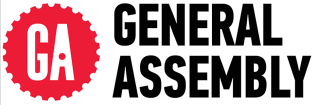
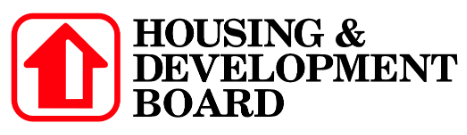

## Table of Contents
1. [Problem Statement](#1.-Problem-Statement)  
2. [Importing Libraries and Data](#2.-Importing-Libraries-and-Data)   
3. [Data Cleaning](#3.-Data-Cleaning)  
4. [Pre-Processing](#4.-Pre-Processing)  
5. [EDA](#5.-EDA)  

# 1. Problem Statement
[Return to top](#Table-of-Contents)

The objective of this project is to design a regression model to predict resale prices of HDB flats, using past 5 years resale HDB data from [data.gov.sg](https://data.gov.sg/dataset/resale-flat-prices).

# 2. Importing Libraries and Data
[Return to top](#Table-of-Contents)

In [1]:
import numpy as np
import pandas as pd
# Pandas settings
pd.set_option('display.max_rows', None)
pd.set_option("display.max_columns", None)

import matplotlib.pyplot as plt
import seaborn as sns
import statistics
import requests
from datetime import datetime as dt
from dateutil.relativedelta import relativedelta
import re

In [2]:
def create_copy(df): #creating a backup DataFrame for reverting to if something goes wrong
    df = df.copy()
    return df

In [3]:
df_hdb = pd.read_csv(f"../data/resale-flat-prices-based-on-registration-date-from-jan-2017-onwards.csv", 
                     parse_dates = ['month','lease_commence_date','remaining_lease'])

In [4]:
# have a look at the shape of the dataset
df_hdb.shape

(125361, 11)

In [5]:
# creating a backup in case need to rollback
df_hdb_backup = create_copy(df_hdb)

# 3. Data Cleaning
[Return to top](#Table-of-Contents)

In [6]:
df_hdb.head()

,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,remaining_lease,resale_price
0,2017-01-01,ANG MO KIO,2 ROOM,406,ANG MO KIO AVE 10,10 TO 12,44.0,Improved,1979-01-01,61 years 04 months,232000.0
1,2017-01-01,ANG MO KIO,3 ROOM,108,ANG MO KIO AVE 4,01 TO 03,67.0,New Generation,1978-01-01,60 years 07 months,250000.0
2,2017-01-01,ANG MO KIO,3 ROOM,602,ANG MO KIO AVE 5,01 TO 03,67.0,New Generation,1980-01-01,62 years 05 months,262000.0
3,2017-01-01,ANG MO KIO,3 ROOM,465,ANG MO KIO AVE 10,04 TO 06,68.0,New Generation,1980-01-01,62 years 01 month,265000.0
4,2017-01-01,ANG MO KIO,3 ROOM,601,ANG MO KIO AVE 5,01 TO 03,67.0,New Generation,1980-01-01,62 years 05 months,265000.0


In [7]:
df_hdb.dtypes

month                  datetime64[ns]
town                           object
flat_type                      object
block                          object
street_name                    object
storey_range                   object
floor_area_sqm                float64
flat_model                     object
lease_commence_date    datetime64[ns]
remaining_lease                object
resale_price                  float64
dtype: object

In [8]:
df_hdb.isnull().sum()
# no empty entries

month                  0
town                   0
flat_type              0
block                  0
street_name            0
storey_range           0
floor_area_sqm         0
flat_model             0
lease_commence_date    0
remaining_lease        0
resale_price           0
dtype: int64

In [9]:
# Check number of duplicates 
n_duplicates = df_hdb.duplicated().sum()
print(f"You seem to have {n_duplicates} duplicates in your database.")

You seem to have 252 duplicates in your database.


In [10]:
df_hdb[df_hdb.duplicated()].index

Int64Index([   243,    305,    510,    591,    672,    736,    737,    764,
               831,   1283,
            ...
            108527, 110867, 112669, 113834, 114152, 115469, 116071, 118666,
            120605, 121619],
           dtype='int64', length=252)

In [11]:
# picking random duplicates to inspect
df_hdb.iloc[[735, 736, 737,112668, 112669, 113833, 113834]]

,month,town,flat_type,block,street_name,storey_range,floor_area_sqm,flat_model,lease_commence_date,remaining_lease,resale_price
735,2017-01-01,PUNGGOL,4 ROOM,302A,PUNGGOL PL,13 TO 15,93.0,Premium Apartment,2011-01-01,93 years 02 months,550000.0
736,2017-01-01,PUNGGOL,4 ROOM,614B,EDGEFIELD PLAINS,16 TO 18,97.0,Model A,2012-01-01,94 years 11 months,468000.0
737,2017-01-01,PUNGGOL,4 ROOM,601C,PUNGGOL CTRL,13 TO 15,94.0,Model A,2012-01-01,94 years 07 months,470000.0
112668,2021-10-01,TOA PAYOH,3 ROOM,233,LOR 8 TOA PAYOH,10 TO 12,66.0,Improved,1981-01-01,59 years 01 month,295000.0
112669,2021-10-01,TOA PAYOH,3 ROOM,234,LOR 8 TOA PAYOH,07 TO 09,65.0,Improved,1976-01-01,54 years,285000.0
113833,2021-03-01,WOODLANDS,4 ROOM,896C,WOODLANDS DR 50,01 TO 03,99.0,Model A,1997-01-01,75 years 04 months,365000.0
113834,2021-03-01,WOODLANDS,4 ROOM,889D,WOODLANDS DR 50,07 TO 09,93.0,Model A,2017-01-01,95 years 05 months,475000.0


**Comment**  
Given the number of duplicated rows and the way the data is presented,  
I believe that they are different units on similar floors being sold for the same price in the same month.   
Hence, I opt to keep all duplicated rows.

In [12]:
# checking unique values of object dtypes
for col in df_hdb.select_dtypes('object').columns:
    print(f'''{col}:
{df_hdb[col].sort_values().unique()}
---''')

town:
['ANG MO KIO' 'BEDOK' 'BISHAN' 'BUKIT BATOK' 'BUKIT MERAH' 'BUKIT PANJANG'
 'BUKIT TIMAH' 'CENTRAL AREA' 'CHOA CHU KANG' 'CLEMENTI' 'GEYLANG'
 'HOUGANG' 'JURONG EAST' 'JURONG WEST' 'KALLANG/WHAMPOA' 'MARINE PARADE'
 'PASIR RIS' 'PUNGGOL' 'QUEENSTOWN' 'SEMBAWANG' 'SENGKANG' 'SERANGOON'
 'TAMPINES' 'TOA PAYOH' 'WOODLANDS' 'YISHUN']
---
flat_type:
['1 ROOM' '2 ROOM' '3 ROOM' '4 ROOM' '5 ROOM' 'EXECUTIVE'
 'MULTI-GENERATION']
---
block:
['1' '10' '100' ... '99C' '9A' '9B']
---
street_name:
['ADMIRALTY DR' 'ADMIRALTY LINK' 'AH HOOD RD' 'ALJUNIED AVE 2'
 'ALJUNIED CRES' 'ALJUNIED RD' 'ANCHORVALE CRES' 'ANCHORVALE DR'
 'ANCHORVALE LANE' 'ANCHORVALE LINK' 'ANCHORVALE RD' 'ANCHORVALE ST'
 'ANG MO KIO AVE 1' 'ANG MO KIO AVE 10' 'ANG MO KIO AVE 2'
 'ANG MO KIO AVE 3' 'ANG MO KIO AVE 4' 'ANG MO KIO AVE 5'
 'ANG MO KIO AVE 6' 'ANG MO KIO AVE 8' 'ANG MO KIO AVE 9'
 'ANG MO KIO ST 11' 'ANG MO KIO ST 21' 'ANG MO KIO ST 31'
 'ANG MO KIO ST 32' 'ANG MO KIO ST 44' 'ANG MO KIO ST 52'
 'ANG MO KIO ST

flat_model:
['2-room' 'Adjoined flat' 'Apartment' 'DBSS' 'Improved'
 'Improved-Maisonette' 'Maisonette' 'Model A' 'Model A-Maisonette'
 'Model A2' 'Multi Generation' 'New Generation' 'Premium Apartment'
 'Premium Apartment Loft' 'Premium Maisonette' 'Simplified' 'Standard'
 'Terrace' 'Type S1' 'Type S2']
---
remaining_lease:
['43 years 09 months' '43 years 10 months' '43 years 11 months' '44 years'
 '44 years 01 month' '44 years 02 months' '44 years 03 months'
 '44 years 04 months' '44 years 05 months' '44 years 06 months'
 '44 years 07 months' '44 years 08 months' '44 years 09 months'
 '44 years 10 months' '44 years 11 months' '45 years' '45 years 01 month'
 '45 years 02 months' '45 years 03 months' '45 years 04 months'
 '45 years 05 months' '45 years 06 months' '45 years 07 months'
 '45 years 08 months' '45 years 09 months' '45 years 10 months'
 '45 years 11 months' '46 years' '46 years 01 month' '46 years 02 months'
 '46 years 03 months' '46 years 04 months' '46 years 05 months'
 '4

# 4. Pre-Processing
[Return to top](#Table-of-Contents)

In [13]:
# creating balance_lease column as float dtype
df_hdb['balance_lease'] = round((((df_hdb['lease_commence_date'].dt.year - df_hdb['month'].dt.year + 99) * 12 + 
                                  (df_hdb['lease_commence_date'].dt.month - df_hdb['month'].dt.month))/12),2)

In [14]:
# grab the set of street_names, 
# run OneMap api to get postal code
# use postal code to impute postal district

street_name_list = list(set(list(df_hdb['street_name'])))
print(len(street_name_list))
print()
print(street_name_list)

# click ... to see output

557

['ADMIRALTY DR', 'MEI LING ST', 'HOUGANG AVE 9', 'CANBERRA ST', 'PASIR RIS ST 71', 'KIM CHENG ST', 'NEW MKT RD', 'SENGKANG WEST AVE', 'ANG MO KIO ST 21', 'TAMPINES AVE 5', 'JURONG WEST CTRL 3', 'TAMPINES ST 11', 'BT BATOK ST 52', 'BT PURMEI RD', 'MARINE CRES', 'WOODLANDS DR 14', 'FERNVALE LINK', 'MONTREAL LINK', 'HOUGANG AVE 4', 'WEST COAST RD', 'WOODLANDS DR 44', 'SMITH ST', 'DAWSON RD', 'BEDOK RESERVOIR CRES', 'WOODLANDS AVE 5', 'HOUGANG ST 22', 'BISHAN ST 12', 'KIM TIAN RD', "C'WEALTH CL", 'TAMPINES ST 45', 'WOODLANDS ST 82', 'PASIR RIS ST 72', 'RIVERVALE WALK', 'DELTA AVE', 'YISHUN AVE 4', 'KG ARANG RD', 'TAMPINES ST 86', 'TAMPINES ST 12', 'GANGSA RD', 'CORPORATION DR', 'TAMPINES ST 82', 'HOUGANG AVE 8', 'SEMBAWANG VISTA', 'PUNGGOL WALK', 'MARSILING RISE', 'SERANGOON AVE 2', 'WOODLANDS DR 40', 'WHAMPOA RD', 'SENGKANG CTRL', 'BRIGHT HILL DR', 'YUNG KUANG RD', 'TAMPINES ST 83', 'LOR 3 GEYLANG', 'COMPASSVALE LANE', 'SERANGOON NTH AVE 4', 'TELOK BLANGAH HTS', 'JURONG WEST ST 75', 

In [15]:
# replacing short forms with the full word for use with OneMap api
replace_dict = {'AVE':'AVENUE', 'RD' : 'ROAD', 'CL' : 'CLOSE','GDNS' : 'GARDENS', 
                'ST' : 'STREET', 'BT' :'BUKIT', 'PL' : 'PLACE',
                'CTRL' : 'CENTRAL', 'DR' : 'DRIVE', 'JLN' : 'JALAN', 
                'CRES' : 'CRESCENT', 'DR' : 'DRIVE', 'LOR' : 'LORONG',
                'HTS' : 'HEIGHTS', 'STH' : 'SOUTH', 'NTH' : 'NORTH', 
                'TER' : 'TERRACE', 'UPP' : 'UPPER', 'KG' : 'KAMPONG', 
                'PK' : 'PARK'
               }

In [16]:
street_name_long = street_name_list.copy()

for word, replacement in replace_dict.items():
    for item in range(len(street_name_long)):
        street_name_long[item] = (re.sub(r'(?<!\S)'+word+'(?!\S)', replacement, street_name_long[item]) )

print(len(street_name_long))
print()
print(street_name_long)

# click ... to see output

557

['ADMIRALTY DRIVE', 'MEI LING STREET', 'HOUGANG AVENUE 9', 'CANBERRA STREET', 'PASIR RIS STREET 71', 'KIM CHENG STREET', 'NEW MKT ROAD', 'SENGKANG WEST AVENUE', 'ANG MO KIO STREET 21', 'TAMPINES AVENUE 5', 'JURONG WEST CENTRAL 3', 'TAMPINES STREET 11', 'BUKIT BATOK STREET 52', 'BUKIT PURMEI ROAD', 'MARINE CRESCENT', 'WOODLANDS DRIVE 14', 'FERNVALE LINK', 'MONTREAL LINK', 'HOUGANG AVENUE 4', 'WEST COAST ROAD', 'WOODLANDS DRIVE 44', 'SMITH STREET', 'DAWSON ROAD', 'BEDOK RESERVOIR CRESCENT', 'WOODLANDS AVENUE 5', 'HOUGANG STREET 22', 'BISHAN STREET 12', 'KIM TIAN ROAD', "C'WEALTH CLOSE", 'TAMPINES STREET 45', 'WOODLANDS STREET 82', 'PASIR RIS STREET 72', 'RIVERVALE WALK', 'DELTA AVENUE', 'YISHUN AVENUE 4', 'KAMPONG ARANG ROAD', 'TAMPINES STREET 86', 'TAMPINES STREET 12', 'GANGSA ROAD', 'CORPORATION DRIVE', 'TAMPINES STREET 82', 'HOUGANG AVENUE 8', 'SEMBAWANG VISTA', 'PUNGGOL WALK', 'MARSILING RISE', 'SERANGOON AVENUE 2', 'WOODLANDS DRIVE 40', 'WHAMPOA ROAD', 'SENGKANG CENTRAL', 'BRIG

In [17]:
# using OneMap api to pull postal codes, which will be imputed into districts.
# for speed, we are using street name only. 
# future instances of this project can consider using full address for more accurate postal codes

def getcoordinates(address):
    req = requests.get('https://developers.onemap.sg/commonapi/search?searchVal='+address+'&returnGeom=Y&getAddrDetails=Y&pageNum=1')
    resultsdict = eval(req.text)
    if len(resultsdict['results'])>0:
        return resultsdict['results'][0]['POSTAL']
    else:
        pass

Below cells are commented out to reduce any variations caused by re-running the api.   
a copy of postal_df is saved to postal_df.csv

In [18]:
# %%time 
# # est. 2mins run time, with some variations in results

# postal_list= []
# count = 0
# failed_count = 0
# for street_name in street_name_long:
#     try:
#         if len(getcoordinates(street_name))>0:
#             count = count + 1
#             print('Extracting',count,'out of',len(street_name_long),'addresses')
#             postal_list.append(getcoordinates(street_name))
#     except:
#         count = count + 1           
#         failed_count = failed_count + 1
#         print('Failed to extract',count,'out of',len(street_name_long),'addresses')
#         postal_list.append(None)
# print('Total Number of Addresses With No Coordinates',failed_count)

# # click ... to see output

In [19]:
# postal_dict = dict(zip(street_name_list, postal_list))
# postal_df = pd.DataFrame([postal_dict]).T.reset_index()
# postal_df.columns = ['street_name', 'postal_code']
# postal_df.to_csv('../data/postal_df.csv', index = False)

In [20]:
# reading in from postal_df.csv for repeatability
postal_df = pd.read_csv('../data/postal_df.csv')

In [21]:
postal_df.shape

(557, 2)

In [22]:
postal_df.head()

,street_name,postal_code
0,JLN BT MERAH,160112
1,WOODLANDS DR 44,737776
2,ANG MO KIO ST 21,569383
3,CHOA CHU KANG ST 64,689100
4,BT BATOK ST 31,650374


In [23]:
# creating a backup in case need to rollback
postal_df_backup = create_copy(postal_df)

In [24]:
# null checks
postal_df.isnull().sum()

street_name    0
postal_code    0
dtype: int64

In [25]:
nil_counts = postal_df[postal_df['postal_code'] == 'NIL'].value_counts().sum()

print(f'Number of postal codes with "NIL": {nil_counts}')
print()

nil_list_index = list(postal_df[postal_df['postal_code'] == 'NIL']['street_name'].index)
print(f'nil_list_index: \n{nil_list_index}')

print()

nil_list_street = list(postal_df[postal_df['postal_code'] == 'NIL']['street_name'])
print(f'nil_list_street: \n{nil_list_street}')

# for reference in case we re-run the notebook
# ['CHOA CHU KANG NTH 5', 'JURONG WEST ST 71', 'UPP SERANGOON RD', 'WOODLANDS DR 73', 'CLEMENTI AVE 2', .....

# click ... to see output

Number of postal codes with "NIL": 41

nil_list_index: 
[22, 39, 55, 87, 93, 94, 106, 112, 115, 122, 138, 163, 179, 182, 198, 205, 215, 216, 224, 225, 259, 278, 289, 305, 337, 340, 341, 346, 356, 358, 360, 370, 398, 421, 446, 476, 500, 505, 514, 517, 554]

nil_list_street: 
['CHOA CHU KANG NTH 5', 'JURONG WEST ST 71', 'UPP SERANGOON RD', 'WOODLANDS DR 73', 'CLEMENTI AVE 2', 'JURONG WEST CTRL 3', 'WEST COAST RD', 'ALJUNIED RD', 'KEAT HONG CL', 'ANG MO KIO AVE 8', 'CHOA CHU KANG AVE 5', 'SEMBAWANG WAY', 'REDHILL RD', 'QUEENSWAY', 'ROWELL RD', 'PUNGGOL WALK', 'PUNGGOL EAST', 'DELTA AVE', 'ZION RD', 'HOUGANG AVE 3', 'KALLANG BAHRU', 'PANDAN GDNS', 'SIMS PL', 'WOODLANDS AVE 3', 'NTH BRIDGE RD', 'BENDEMEER RD', 'CHOA CHU KANG AVE 7', 'GEYLANG BAHRU', 'WOODLANDS AVE 5', 'CLEMENTI AVE 6', 'CHANGI VILLAGE RD', 'PAYA LEBAR WAY', "C'WEALTH AVE WEST", 'PUNGGOL RD', 'CASHEW RD', 'BEACH RD', 'KEAT HONG LINK', 'QUEEN ST', 'BOON KENG RD', 'CHOA CHU KANG NTH 7', 'UPP BOON KENG RD']


In [26]:
# creating a list of postal codes to replace "NIL" values
nil_list_postal = [680761, 641712, 347694, 731684, 120334, 648338, 120701, 380125, 683801, 560509, 681484, 750355,
                   151075, 149053, 207994, 828790, 828824, 160001, 247775, 530016, 330064, 600412, 380046, 730347, 
                   198702, 339914, 680810, 330068, 730361, 120206, 500004, 381120, 120415, 822443, 679664, 199588, 
                   682816, 182269,  330008, 689527, 380005
                  ]

print(f'nil_list_index length: {len(nil_list_index)}')
print(f'nil_list_postal length: {len(nil_list_postal)}')

nil_list_index length: 41
nil_list_postal length: 41


In [27]:
# replacing NIL with their actual postal codes
for x in range(len(nil_list_index)):
    postal_df['postal_code'][nil_list_index[x]] = nil_list_postal[x]

In [28]:
# check 
postal_df.loc[nil_list_index]

,street_name,postal_code
22,CHOA CHU KANG NTH 5,680761
39,JURONG WEST ST 71,641712
55,UPP SERANGOON RD,347694
87,WOODLANDS DR 73,731684
93,CLEMENTI AVE 2,120334
...,...,...
500,KEAT HONG LINK,682816
505,QUEEN ST,182269
514,BOON KENG RD,330008
517,CHOA CHU KANG NTH 7,689527


In [29]:
# truncating postal codes since postal districts only refer to 1st 2 digits of the postal code
postal_df['postal_code'] = postal_df['postal_code'].values.astype(str)
postal_df['postal_code_trunc'] = postal_df['postal_code'].apply(lambda x: x[0:2])

In [30]:
#  postal codes starting [78, 80] belong to district 28. 
district_postal_list = ['01', '02', '03', '04', '05', '06', '07', '08', '14', '15', '16', '09', '10', '11', '12', '13',
                        '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30',
                        '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', 
                        '45', '46', '47', '48', '49', '50', '81', '51', '52', '53', '54', '55', '82', '56',
                        '57', '58', '59', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70',
                        '71', '72', '73', '77', '78', '75', '76', '79', '80'                        
                       ]

district_list = [1, 1, 1, 1, 1, 1, 2, 2, 3, 3, 3, 4, 4, 5, 5, 5, 6, 7, 7, 8, 8, 9, 9, 10, 10, 10, 10, 11, 11, 11,
                 12, 12, 12, 13, 13, 13, 13, 14, 14, 14, 14, 15, 15, 15, 15, 16, 16, 16, 17, 17, 17, 18, 18, 
                 19, 19, 19, 19, 20, 20, 21, 21, 22, 22, 22, 22, 22, 23, 23, 23, 23, 24, 24, 24, 25, 25, 26, 26, 
                 27, 27, 28, 28
                ]

In [31]:
district_df = pd.DataFrame(zip(district_list, district_postal_list))
district_df.columns = ['district', 'postal_code_trunc']

In [32]:
postal_district_df = postal_df.merge(district_df, on='postal_code_trunc')
postal_district_df.head()

,street_name,postal_code,postal_code_trunc,district
0,JLN BT MERAH,160112,16,3
1,JLN MEMBINA,169479,16,3
2,HAVELOCK RD,161022,16,3
3,KIM PONG RD,160049,16,3
4,CHIN SWEE RD,160051,16,3


In [33]:
df_hdb = df_hdb.merge(postal_district_df[['street_name','district']], on=['street_name'], how='left')

In [34]:
df_hdb['district'] = df_hdb['district'].astype(int)
df_hdb['resale_price'] = df_hdb['resale_price'].astype(int)

In [35]:
# creating year and month column for EDA 
df_hdb['date'] = df_hdb['month']
df_hdb['year_sold'] = df_hdb['date'].dt.year
df_hdb['month_sold'] = df_hdb['date'].dt.month

# impute floor area into sqft
df_hdb['floor_area_sqft'] = df_hdb['floor_area_sqm']*10.764

# impute unit price from resale price & floor area
df_hdb['unit_price_$psf'] = round(df_hdb['resale_price'] / df_hdb['floor_area_sqft'],2)

# creating type_of_unit variable by concatinating flat type & flat model
df_hdb['type_of_unit'] = ('hdb ' + df_hdb['flat_type'] + ' ' + df_hdb['flat_model']).str.lower()
df_hdb['flat_type'] = df_hdb['flat_type'].str.lower()
df_hdb['flat_model'] = df_hdb['flat_model'].str.lower()

In [36]:
df_hdb_cleaned = df_hdb[['date', 'year_sold','month_sold', 'lease_commence_date', 'balance_lease',
                         'town', 'street_name', 'district', 'storey_range',
                         'flat_type', 'flat_model', 'type_of_unit', 'floor_area_sqft', 'resale_price',
                         'unit_price_$psf'
                        ]]

In [37]:
df_hdb_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 125361 entries, 0 to 125360
Data columns (total 15 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   date                 125361 non-null  datetime64[ns]
 1   year_sold            125361 non-null  int64         
 2   month_sold           125361 non-null  int64         
 3   lease_commence_date  125361 non-null  datetime64[ns]
 4   balance_lease        125361 non-null  float64       
 5   town                 125361 non-null  object        
 6   street_name          125361 non-null  object        
 7   district             125361 non-null  int32         
 8   storey_range         125361 non-null  object        
 9   flat_type            125361 non-null  object        
 10  flat_model           125361 non-null  object        
 11  type_of_unit         125361 non-null  object        
 12  floor_area_sqft      125361 non-null  float64       
 13  resale_price  

# 5. EDA
[Return to top](#Table-of-Contents)

- Map of Singapore (Postal District)
- Scatterplot
- Heatmap
- [No. of sale transactions](#No.-of-sale-transactions)  
 - [by district](#by-district)  
 - [by district, year on year](#by-district,-year-on-year)
 - [by type of unit](#by-type-of-unit)  
 - [by flat type](#by-flat-type)  
 - [by flat type, month on month](#by-flat-type,-month-on-month)
 - [by type of unit, comparison by postal district](#by-type-of-unit,-comparison-by-postal-district)  
 - [by flat type, comparison by postal district](#by-flat-type,-comparison-by-postal-district)  


- [Price](#Price)  
 - [Mean price per property type](#Mean-price-per-property-type)  
 - [Mean \$psf per property type](#Mean-$psf-per-property-type)
 - [No. of sale transactions above 1m, sorted by town](#No.-of-sale-transactions-above-1m,-sorted-by-town)
 - [Unit price per square feet by postal district](#Unit-price-per-square-feet-by-postal-district)
 - [Resale prices by district](#Resale-prices-by-district)
 - [Resale prices by year, split by flat type](#Resale-prices-by-year,-split-by-flat-type)
 - [Resale prices by balance lease](#Resale-prices-by-balance-lease)
 - [Unit price vs storey range, year on year](#Unit-price-vs-storey-range,-year-on-year)
 - [Mean unit price per square foot by district, year on year](#Mean-unit-price-per-square-foot-by-district,-year-on-year)

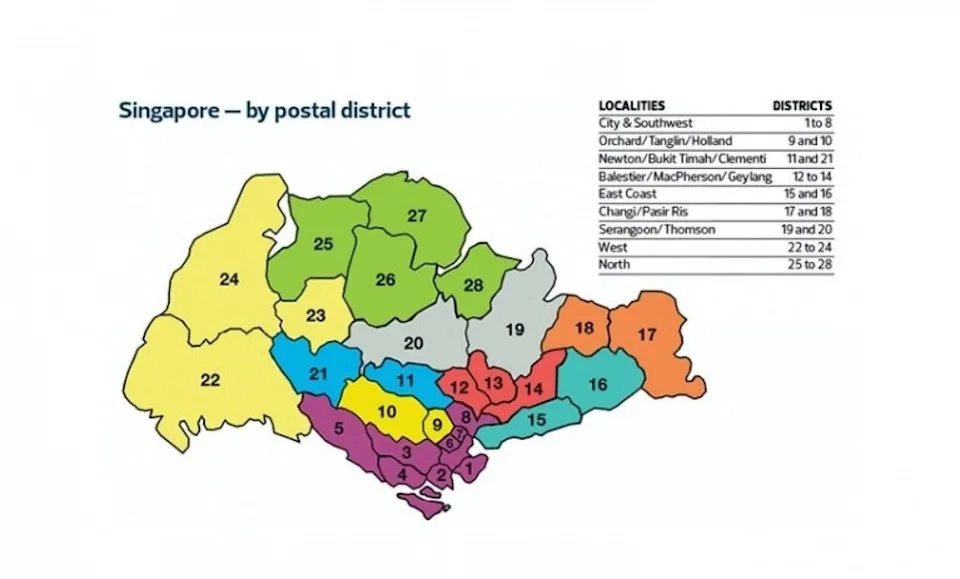
[Source](https://sg.finance.yahoo.com/news/residential-transactions-contracts-dated-mar-000000847.html)

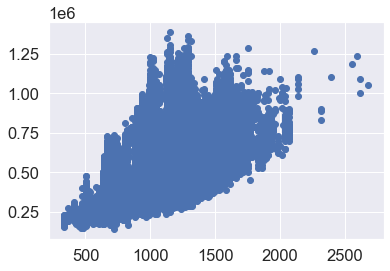

In [38]:
# quick look at scatter plot for obvious outliers
sns.set(font_scale = 1.5)
plt.scatter(df_hdb_cleaned['floor_area_sqft'],df_hdb_cleaned['resale_price'])
# No obvious outliers seen, flats with floor area > 2300 sqft might need more data to better train a model

<ipython-input-39-4987daf7f0eb>:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(corr, dtype=np.bool))


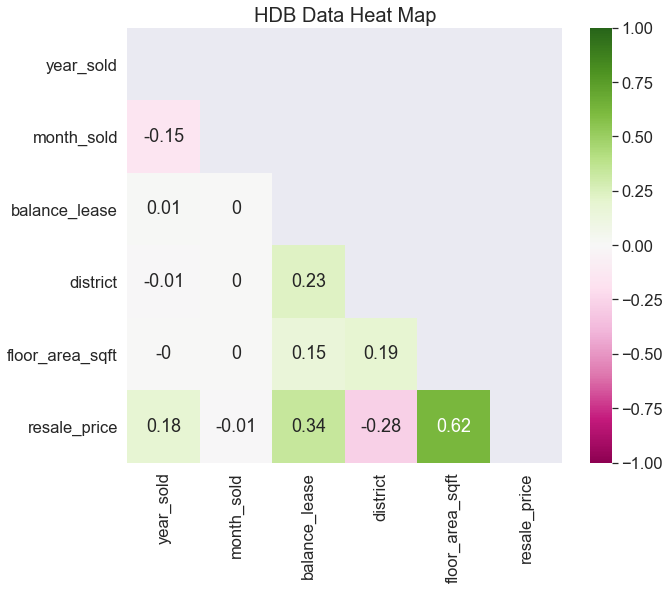

In [39]:
# drawing a heat map to have a visual que at the correlation of the variables

corr = round(df_hdb_cleaned.drop('unit_price_$psf', axis =1).corr(),2) 
mask = np.triu(np.ones_like(corr, dtype=np.bool))

plt.figure(figsize=(10,8))
plt.title('HDB Data Heat Map',fontsize = 20)
sns.heatmap(data = corr, vmin = -1, vmax=1,annot=True, square=True, cmap="PiYG", mask = mask);

In [40]:
df_hdb_cleaned.drop('unit_price_$psf', axis =1).corr()['resale_price'].sort_values(ascending=False)[1:]

floor_area_sqft    0.619727
balance_lease      0.335152
year_sold          0.178240
month_sold        -0.006271
district          -0.284156
Name: resale_price, dtype: float64

## No. of sale transactions
[Back to EDA](#5.-EDA)  

### by district

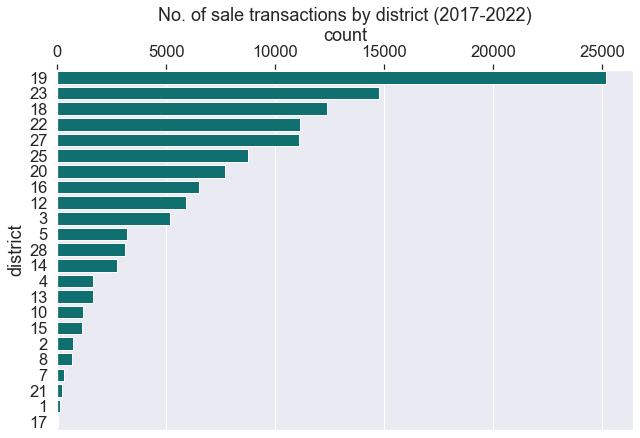

In [41]:
fig = plt.figure(figsize=(8,5))
ax = fig.add_axes([0,0,1,1])

ax.xaxis.tick_top()
ax.xaxis.set_ticks_position('top')
# ax.xaxis.label.set_fontsize(16) 
# ax.yaxis.label.set_fontsize(16) 

ax.set_label('count')
ax.xaxis.set_label_position('top')

sns.set(font_scale = 1.5)
sns.countplot(
    data=df_hdb_cleaned, 
    y='district',
    order=df_hdb_cleaned['district'].value_counts().sort_values(ascending=False).index,
    color='teal'
)

plt.title('No. of sale transactions by district (2017-2022)')
plt.show()

**Comment**  
It appears that district 19, which comprises of Hougang, Seng Kang & Punggol has the highest number of resale transactions over the last 5 years. A driving factor would be that the newer flats would have achieved Minimum Occupancy Period (MOP) and the home owners are looking to upgrade their home.

### by district, year on year
[Back to EDA](#5.-EDA)  

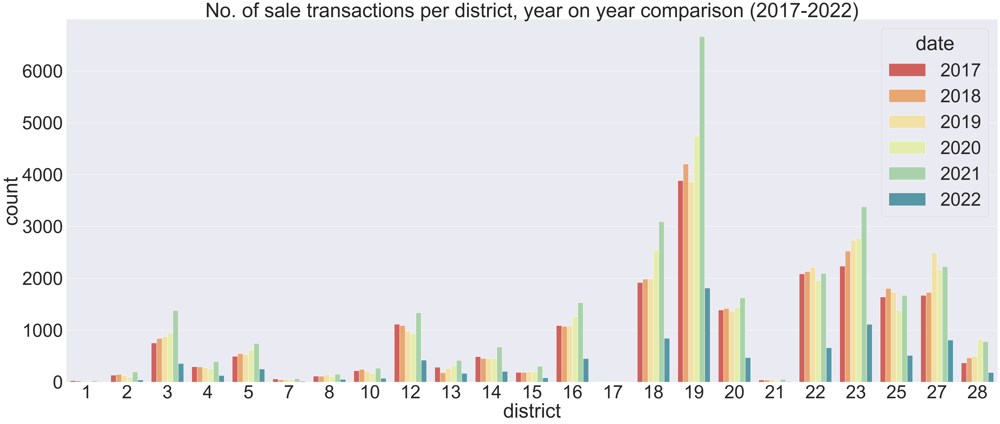

In [42]:
plt.figure(figsize=(50,20), dpi=200)

sns.set(font_scale = 5)
sns.countplot(
    data=df_hdb_cleaned,
    x='district',
    palette='Spectral',
    hue=df_hdb_cleaned['date'].dt.year
)

plt.title('No. of sale transactions per district, year on year comparison (2017-2022)')
plt.show()

**Comment**  
Year 2021 seen the most number of sale transactions, very likely due to the COVID19 lockdown in Singapore, and also travel bans worldwide. Families would opt to upgrade to bigger units, and even condominiums where there is more space and facilities for the family members.   

Another possible reason for this phenomenon could be that home owners could not travel, so they decide to channel those monies into real estate for potential capital gains.

### by type of unit
[Back to EDA](#5.-EDA)  

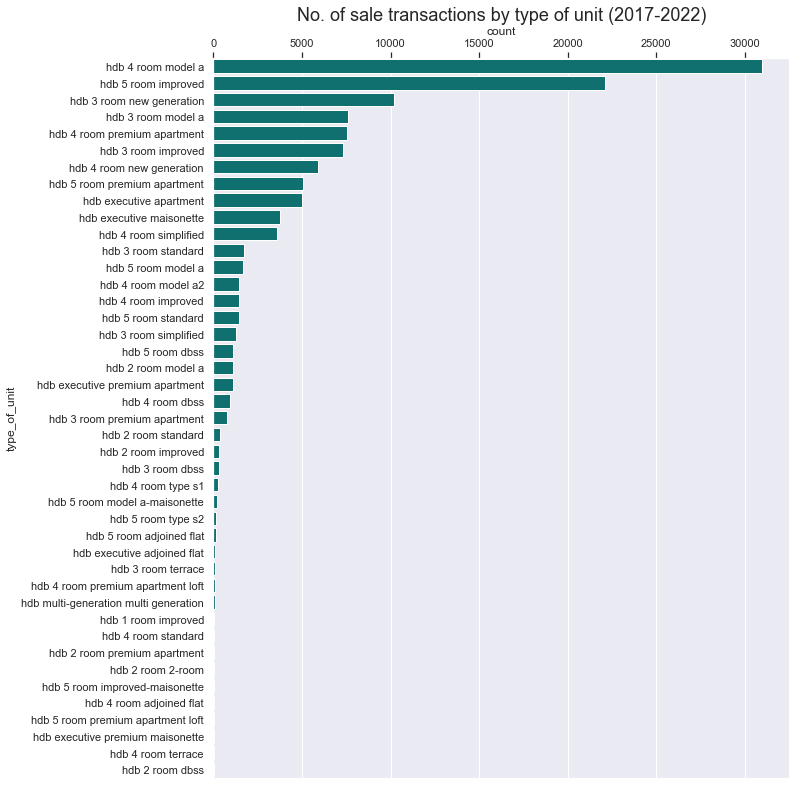

In [62]:
fig = plt.figure(figsize=(8,10))
ax = fig.add_axes([0,0,1,1])

ax.xaxis.tick_top()
ax.xaxis.set_ticks_position('top')
ax.set_label('count')
ax.xaxis.set_label_position('top')

sns.set(font_scale = 1.5)
sns.countplot(
    data=df_hdb_cleaned, 
    y='type_of_unit',
    order=df_hdb_cleaned['type_of_unit'].value_counts().sort_values(ascending=False).index,
    color='teal')

plt.title('No. of sale transactions by type of unit (2017-2022)')
plt.show()

In [44]:
df_hdb_cleaned['type_of_unit'].value_counts(normalize=True).head(3)

hdb 4 room model a           0.247206
hdb 5 room improved          0.176411
hdb 3 room new generation    0.081277
Name: type_of_unit, dtype: float64

**Comment**  
"4 room model a" makes up 24.7% of the total sale transactions from 2017 to 2022.   
"5 room improved" makes up 17.6% of the total sale transactions from 2017 to 2022.   

It is clear that these two types of HDB are the most commonly traded.  

This is likely due to young dual income families upgrading their BTOs to acquire a condominium for its prestige, and also its facilites for their children.

### by flat type
[Back to EDA](#5.-EDA)  

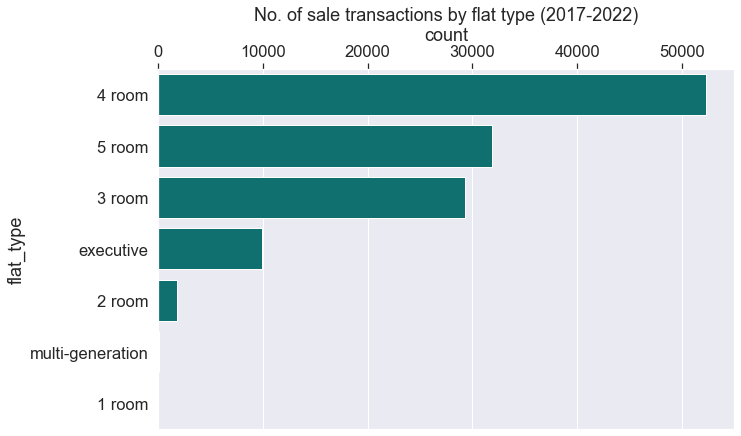

In [63]:
fig = plt.figure(figsize=(8,5))
ax = fig.add_axes([0,0,1,1])

ax.xaxis.tick_top()
ax.xaxis.set_ticks_position('top')
ax.set_label('count')
ax.xaxis.set_label_position('top')

sns.set(font_scale = 1.5)
sns.countplot(
    data=df_hdb_cleaned, 
    y='flat_type',
    order=df_hdb_cleaned['flat_type'].value_counts().sort_values(ascending=False).index,
    color='teal')

plt.title('No. of sale transactions by flat type (2017-2022)')
plt.show()

### by flat type, month on month
[Back to EDA](#5.-EDA)  

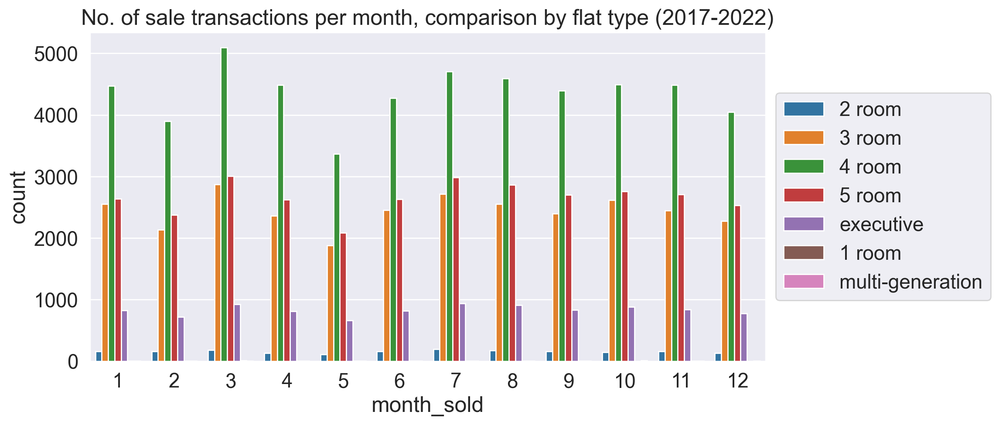

In [46]:
plt.figure(figsize=(10,5),dpi=200)
sns.countplot(
    data=df_hdb_cleaned, 
    x='month_sold',
    palette='tab10',
    hue='flat_type'
)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.title('No. of sale transactions per month, comparison by flat type (2017-2022)')
plt.show()

**Comment**  
The month of May showed the least transcations accross all flat types.  

Best time to sell would be in March as it clocked the most transactions across all flat types.

### by type of unit, comparison by postal district  
[Back to EDA](#5.-EDA)  

In [47]:
plt.figure(figsize=(30,500))

sns.set(font_scale = 6)
sns.countplot(
    data=df_hdb_cleaned,
    y='type_of_unit',
    hue='district',
    palette='Paired'
)

plt.legend()
plt.title('No. of sale transactions per type of unit, comparison by postal district (2017-2022)')
plt.show()

### by flat type, comparison by postal district
[Back to EDA](#5.-EDA)  

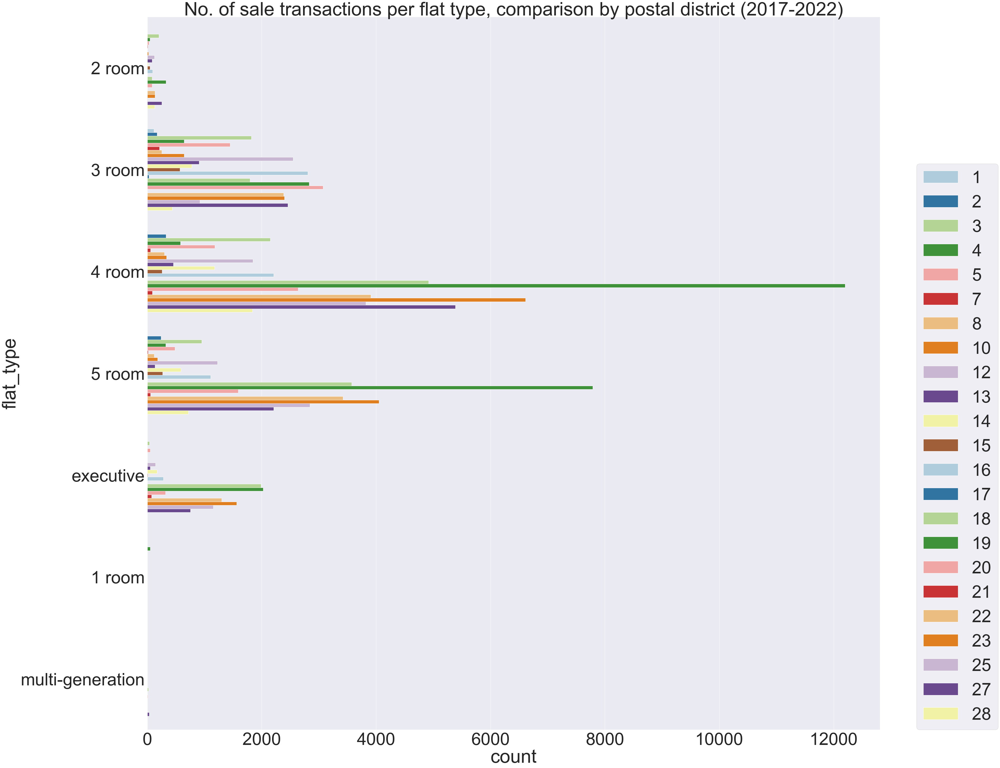

In [48]:
plt.figure(figsize=(50,50))

sns.set(font_scale = 6)
sns.countplot(
    data=df_hdb_cleaned,
    y='flat_type',
    hue='district',
    palette='Paired'
)

plt.legend(loc=(1.05,0))
plt.title('No. of sale transactions per flat type, comparison by postal district (2017-2022)')
plt.show()

## Price
[Back to EDA](#5.-EDA)  

### Mean price per property type
[Back to EDA](#5.-EDA)  

In [49]:
df_hdb_cleaned.groupby('type_of_unit')['resale_price'].mean().sort_values(ascending=False).head(6)

type_of_unit
hdb 5 room type s2                   1.076088e+06
hdb 5 room premium apartment loft    9.654517e+05
hdb 4 room type s1                   9.596090e+05
hdb 4 room terrace                   9.227500e+05
hdb 4 room premium apartment loft    9.107916e+05
hdb 5 room dbss                      8.652430e+05
Name: resale_price, dtype: float64

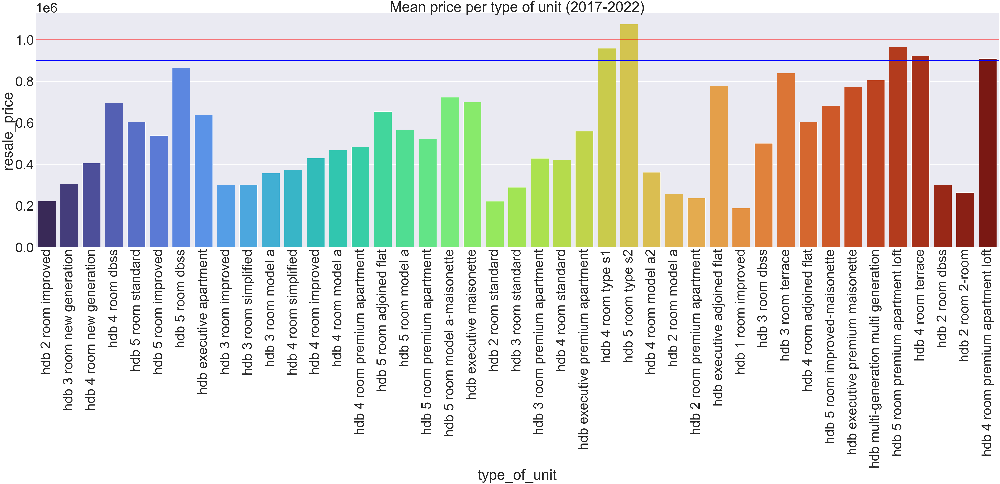

In [50]:
plt.figure(figsize=(100,25))

sns.set(font_scale = 7)
mean_price = sns.barplot(data=df_hdb_cleaned,
                         x='type_of_unit',
                         y='resale_price',
                         ci=None,
                         estimator=np.mean,
                         palette='turbo',
                         )

plt.axhline(y=1e6, color='red', linestyle='-', linewidth=4)
plt.axhline(y=9e5, color='blue', linestyle='-', linewidth=4)
plt.setp(mean_price.get_xticklabels(), rotation=90)
plt.title('Mean price per type of unit (2017-2022)')
plt.show()

**Comment**  
Mean resale prices above 1 million: 
- "5 room type s2"  



Mean resale prices above 900_000: 
- "hdb 5 room premium apartment loft"
- "hdb 4 room type s1"
- "hdb 4 room terrace"
- "hdb 4 room premium apartment loft"

### Mean $psf per property type
[Back to EDA](#5.-EDA)  

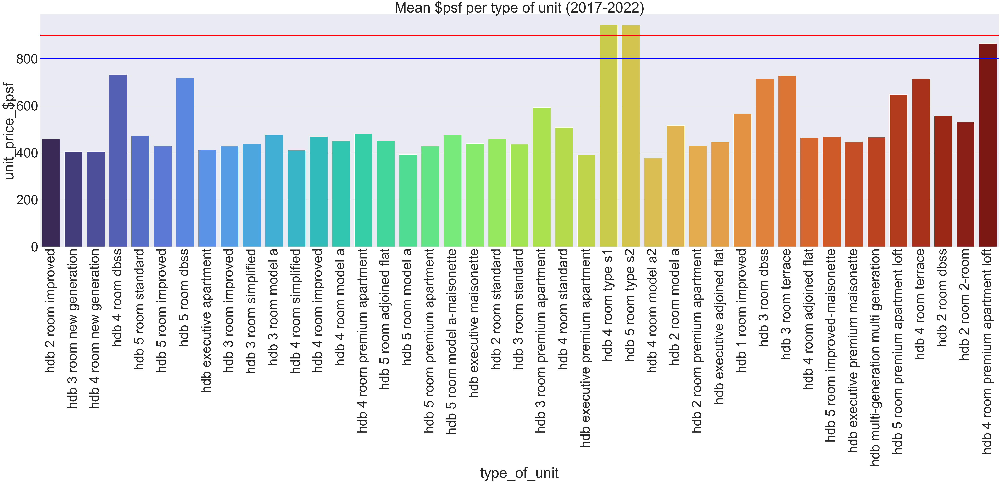

In [51]:
plt.figure(figsize=(100,25))

sns.set(font_scale = 7)
mean_price = sns.barplot(data=df_hdb_cleaned,
                         x='type_of_unit',
                         y='unit_price_$psf',
                         ci=None,
                         estimator=np.mean,
                         palette='turbo',
                         )

plt.axhline(y=900, color='red', linestyle='-', linewidth=4)
plt.axhline(y=800, color='blue', linestyle='-', linewidth=4)
plt.setp(mean_price.get_xticklabels(), rotation=90)
plt.title('Mean $psf per type of unit (2017-2022)')
plt.show()

In [52]:
df_hdb_cleaned.groupby('type_of_unit')['unit_price_$psf'].mean().sort_values(ascending=False).head()

type_of_unit
hdb 4 room type s1                   944.572588
hdb 5 room type s2                   941.966222
hdb 4 room premium apartment loft    864.970152
hdb 4 room dbss                      729.780543
hdb 3 room terrace                   726.046714
Name: unit_price_$psf, dtype: float64

**Comment**  
Mean resale prices above $900 psf: 
- "hdb 4 room type s1"  
- "hdb 5 room type s2"

Mean resale prices above $800 psf: 
- "hdb 4 room premium apartment loft"

### No. of sale transactions above 1m, sorted by town
[Back to EDA](#5.-EDA)  

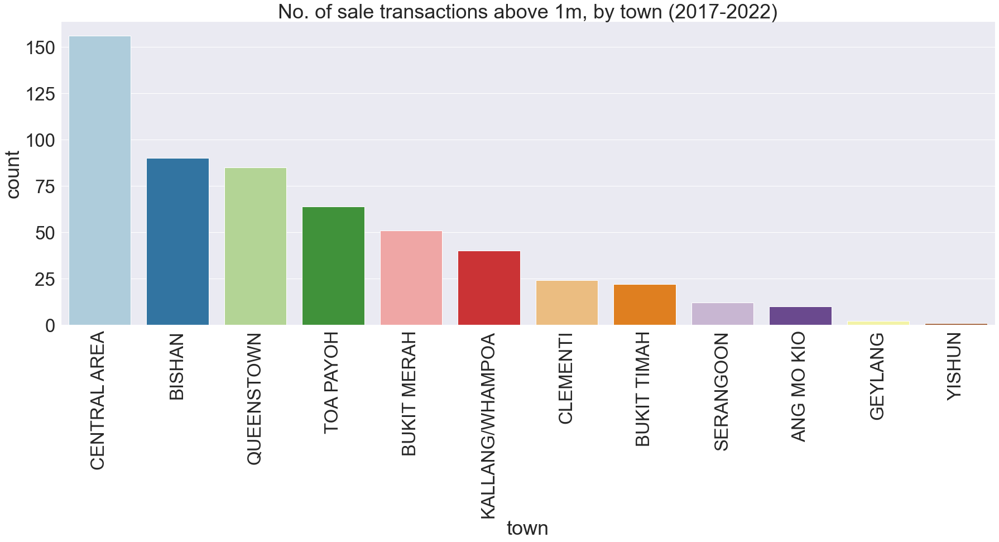

In [53]:
mil_df = df_hdb_cleaned[df_hdb_cleaned['resale_price'] > 1e6]

plt.figure(figsize=(30,10))

sns.set(font_scale = 3)
mil = sns.countplot(
    data=mil_df ,
    x ='town',
    palette='Paired',
    order = mil_df['town'].value_counts().index
)

plt.setp(mil.get_xticklabels(), rotation=90)
plt.title('No. of sale transactions above 1m, by town (2017-2022)')
plt.show()

### Unit price per square feet by postal district
[Back to EDA](#5.-EDA)  

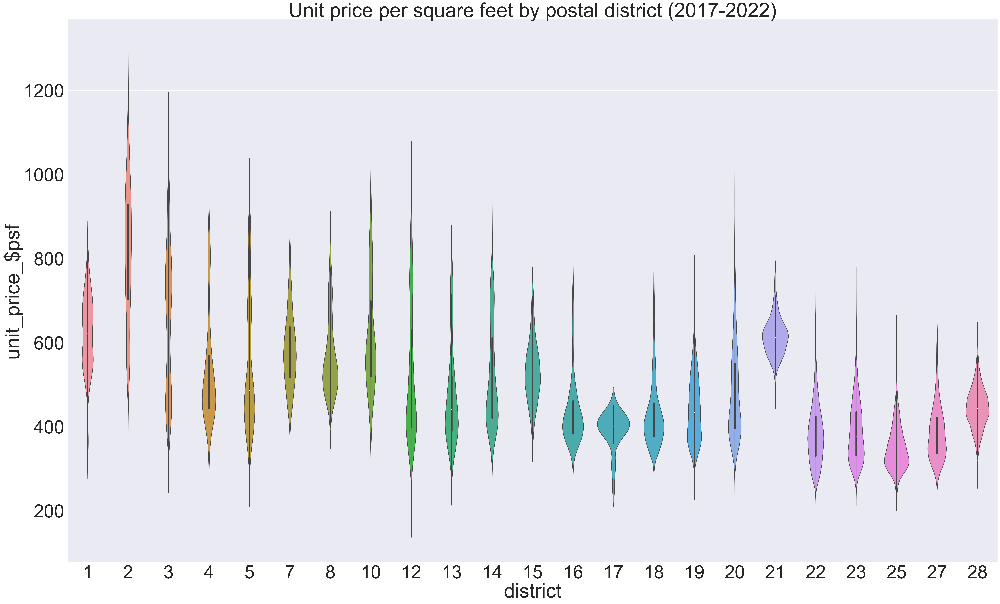

In [54]:
plt.figure(figsize=(50,30),dpi=200)
sns.set(font_scale = 5)
sns.violinplot(data=df_hdb_cleaned,x='district',y='unit_price_$psf')
plt.title('Unit price per square feet by postal district (2017-2022)')
plt.show()

### Resale prices by district
[Back to EDA](#5.-EDA)  

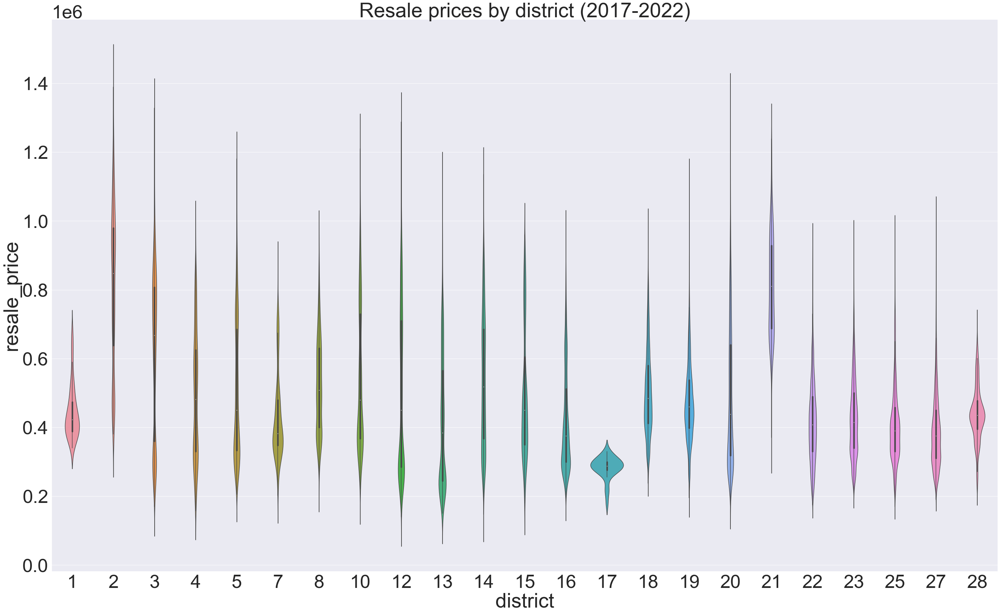

In [55]:
plt.figure(figsize=(50,30))
sns.set(font_scale = 5)
sns.violinplot(data=df_hdb_cleaned,x='district', y = 'resale_price')
plt.title(f'Resale prices by district (2017-2022)')
plt.show()

### Resale prices by year, split by flat type
[Back to EDA](#5.-EDA)  

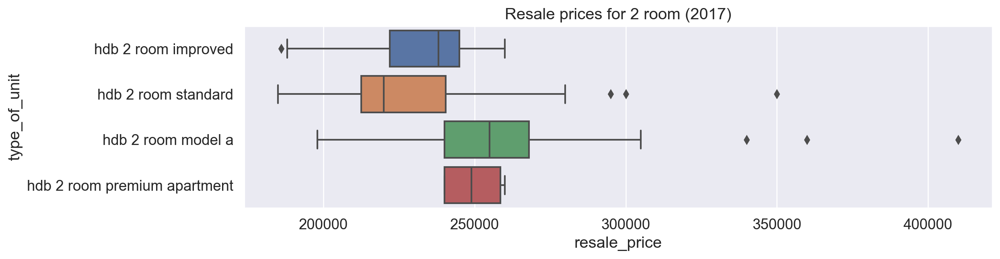

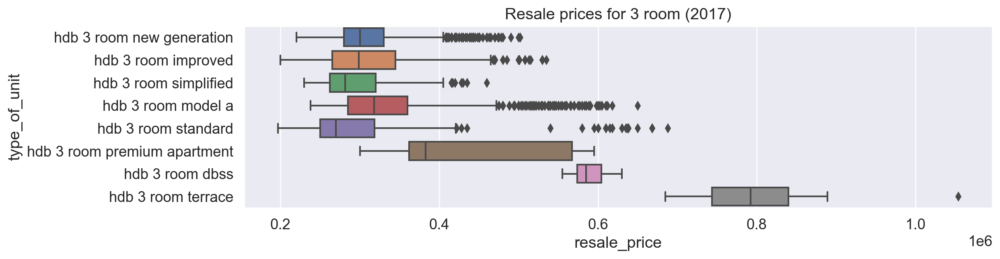

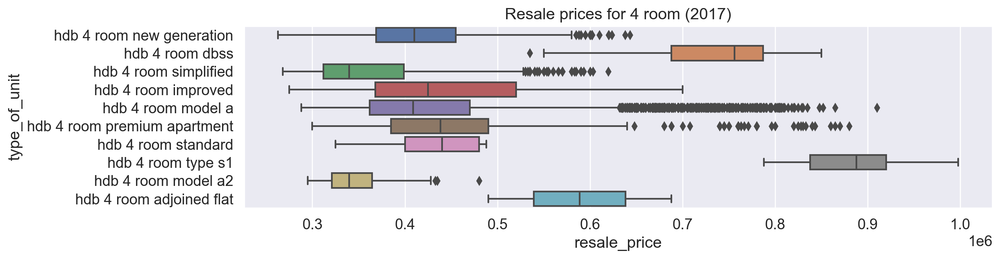

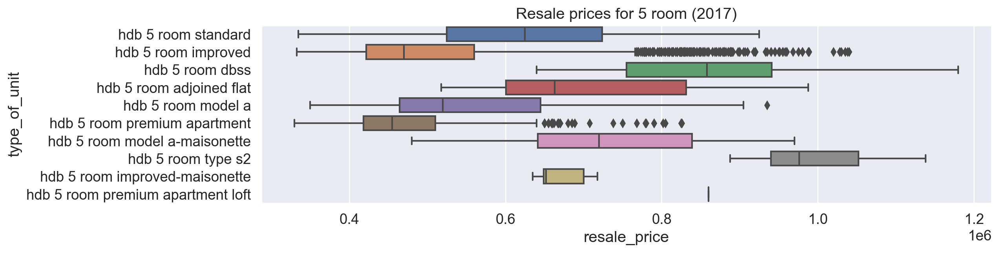

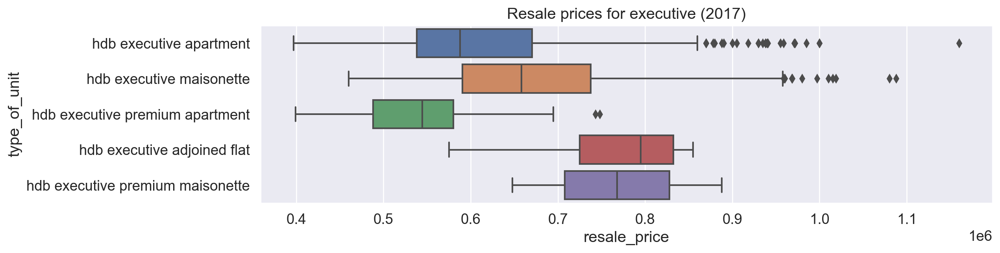

...

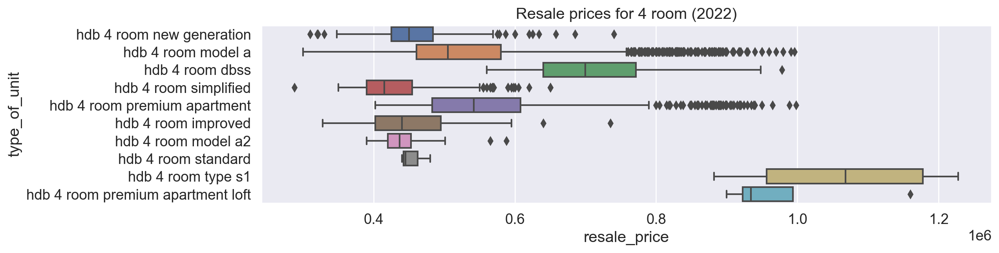

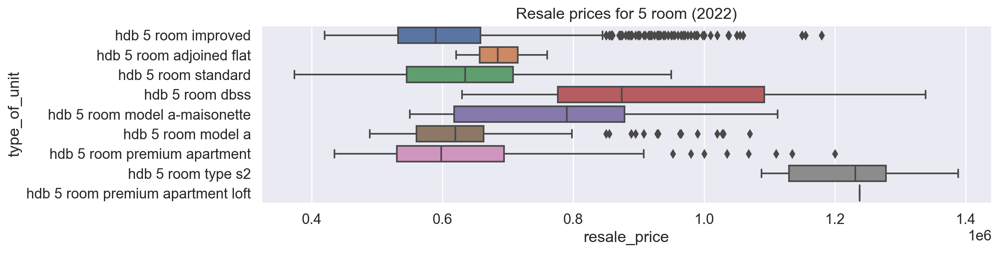

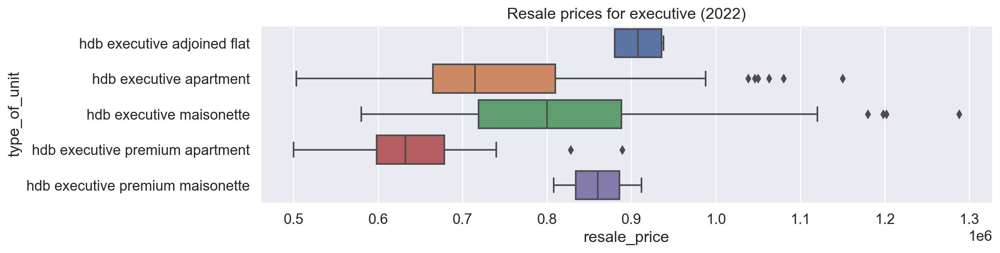

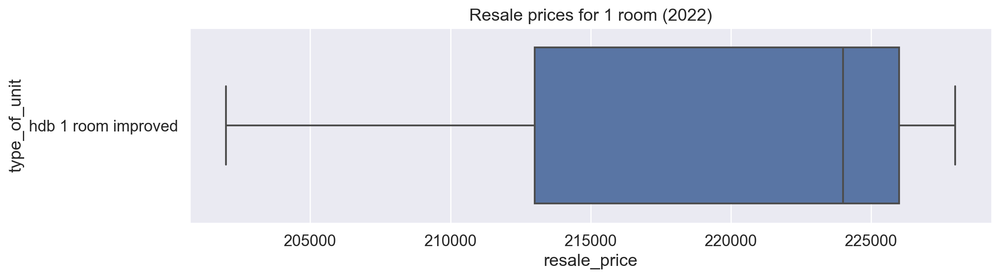

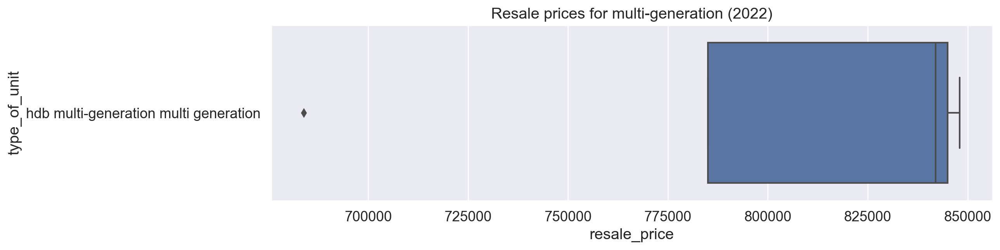

In [56]:
flat_type_list = list(df_hdb_cleaned['flat_type'].unique())
year_list = list(df_hdb_cleaned['year_sold'].unique())

x = 2017
for year in year_list:
    split_by_year = df_hdb_cleaned[df_hdb_cleaned['year_sold'] == year]
    for flat_type in flat_type_list:
        plt.figure(figsize=(12,3),dpi=200)
        sns.set(font_scale = 1.2)
        sns.boxplot(data=split_by_year[split_by_year['flat_type'] == flat_type],x='resale_price', y = 'type_of_unit')
        plt.title(f'Resale prices for {flat_type} ({x})')
        plt.show()
    x+=1

### Resale prices by balance lease
[Back to EDA](#5.-EDA)  

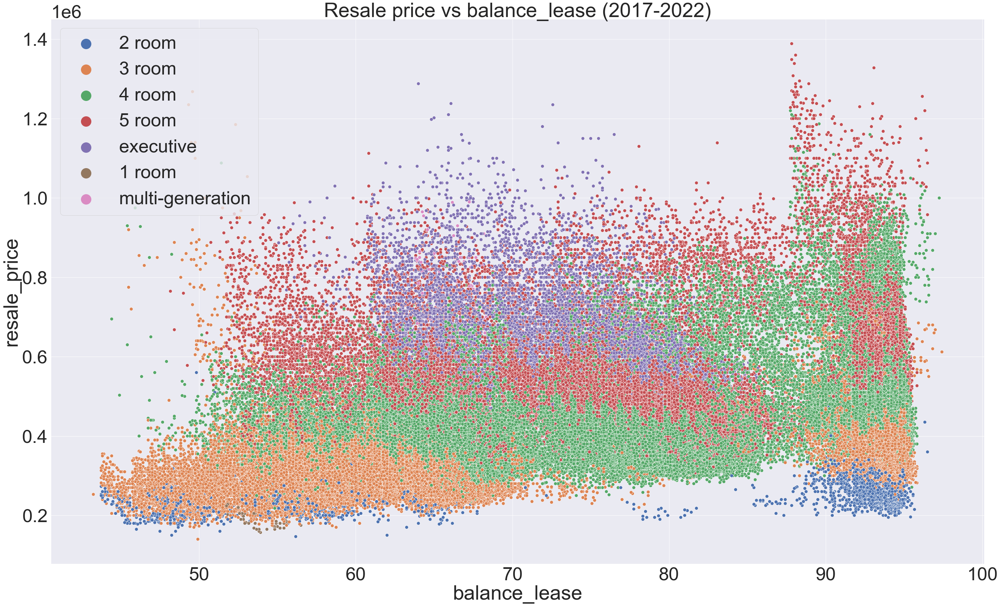

In [57]:
plt.figure(figsize=(50,30))
sns.set(font_scale = 5)
sns.scatterplot(data=df_hdb_cleaned,x='balance_lease',y='resale_price', hue='flat_type', s=100)
plt.title('Resale price vs balance_lease (2017-2022)')
plt.legend(markerscale = 5)

plt.show()

### Unit price vs storey range, year on year
[Back to EDA](#5.-EDA)  

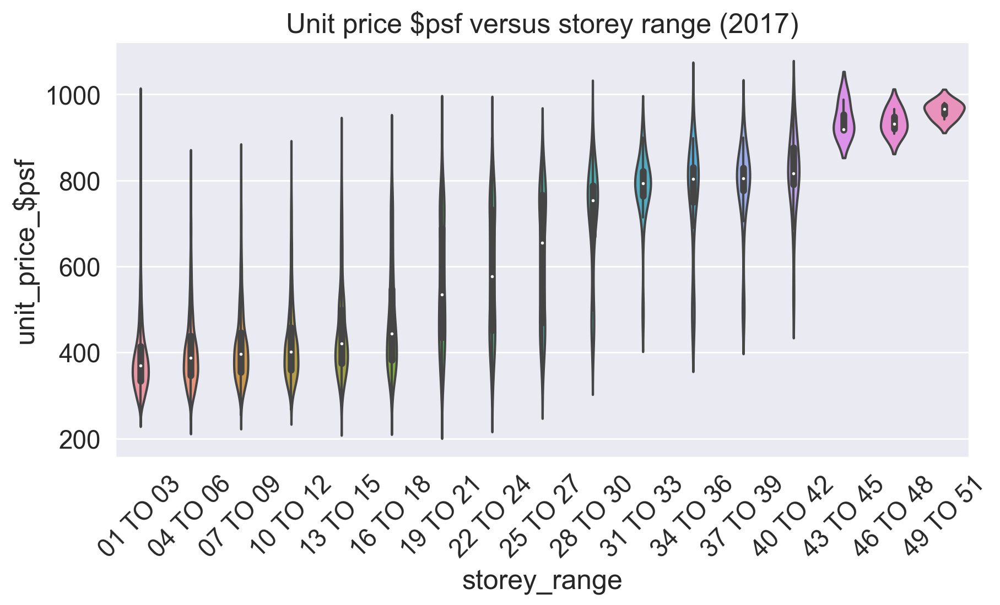

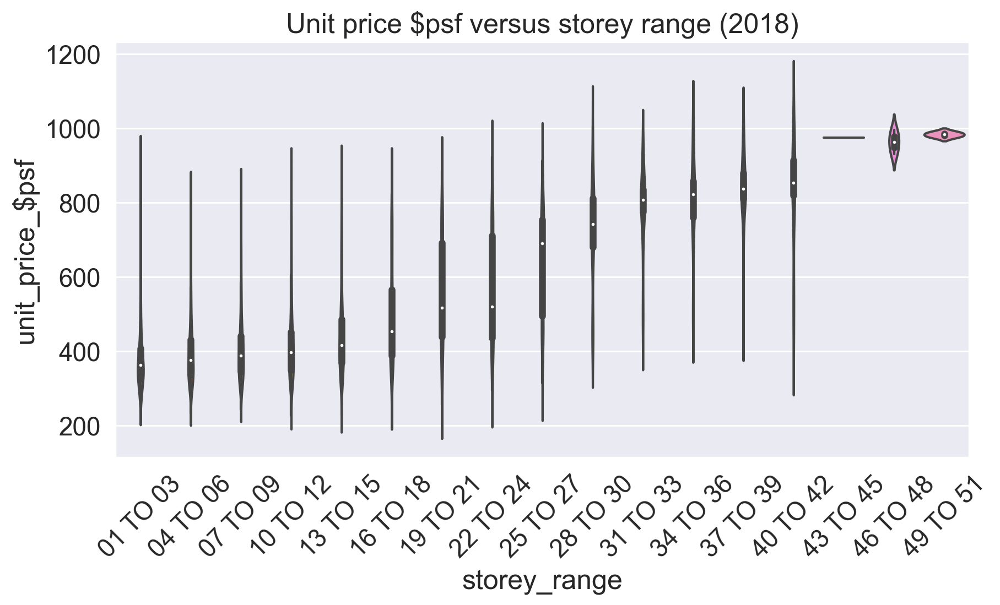

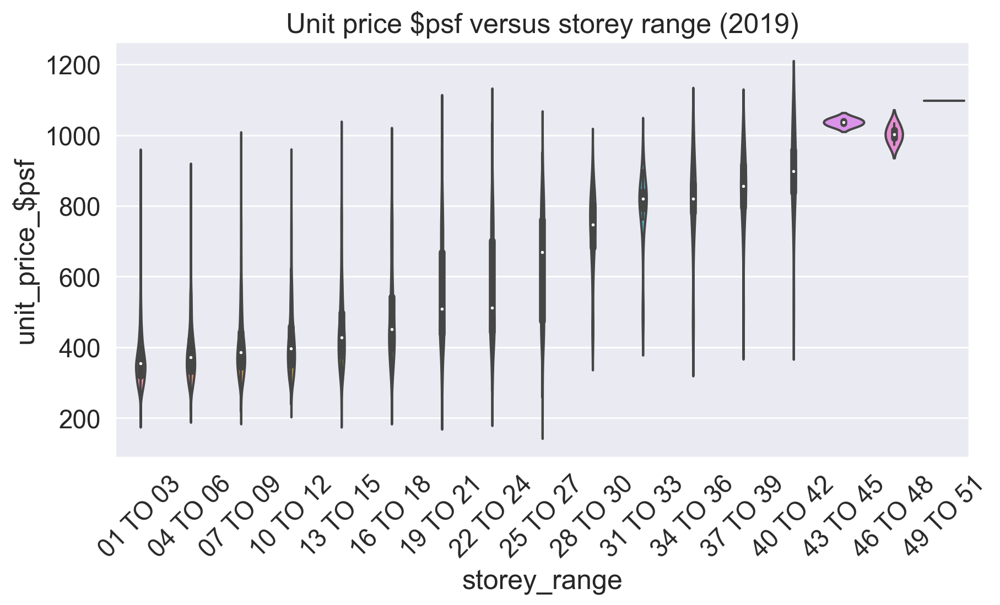

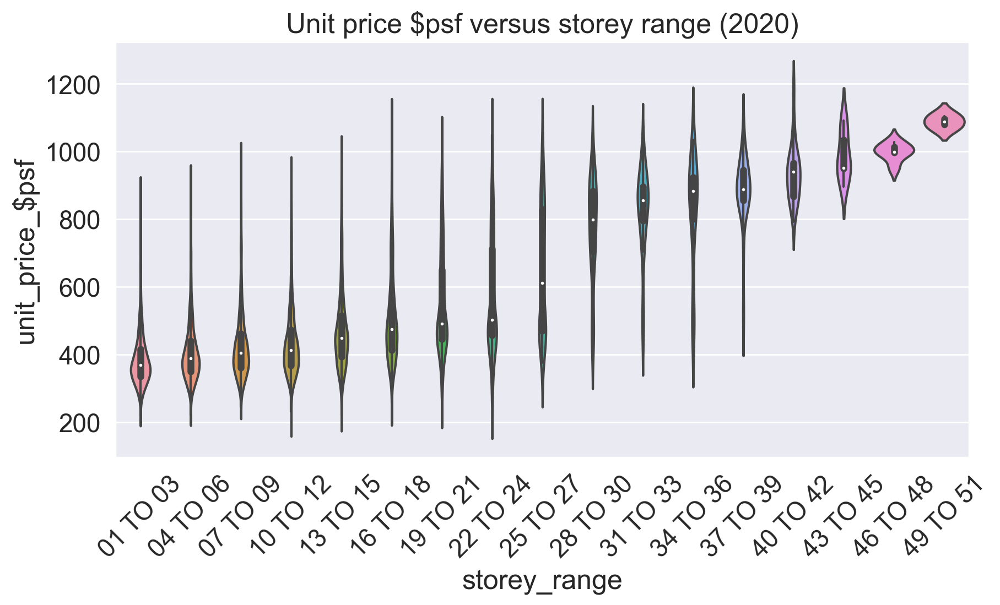

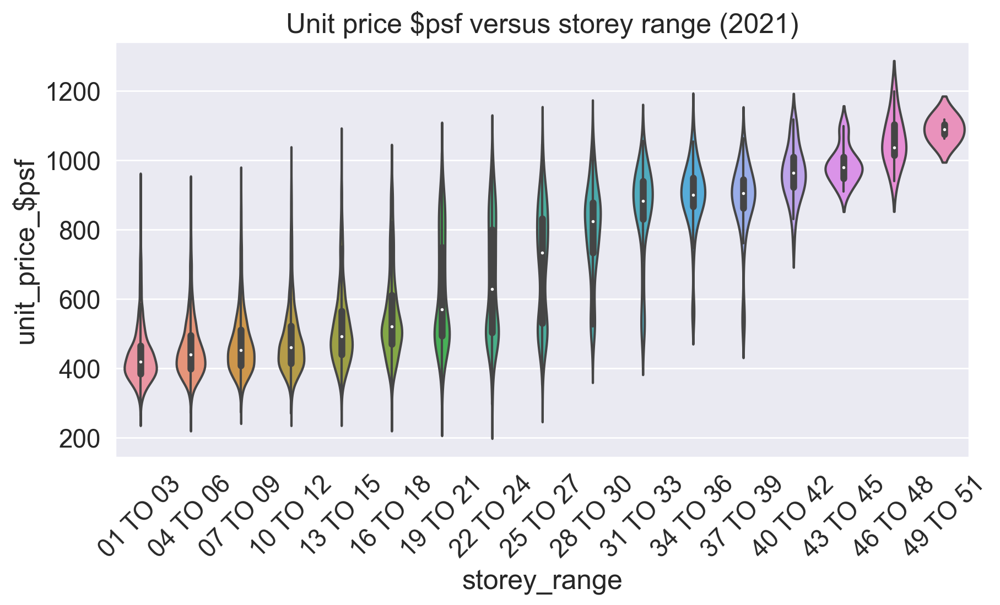

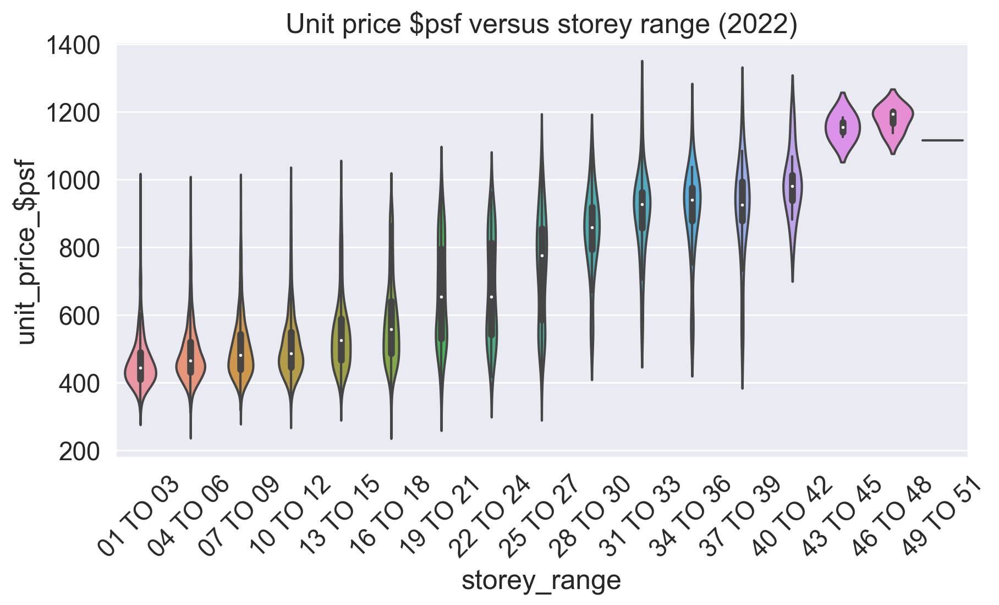

In [58]:
year_list = list(df_hdb_cleaned['year_sold'].unique())
storey_for_plt = df_hdb_cleaned.sort_values(by='storey_range')

x = 2017

sns.set(font_scale = 1.5)
for year in year_list:
    split_by_year = df_hdb_cleaned[df_hdb_cleaned['year_sold'] == year]
    plt.figure(figsize=(10,5),dpi=200)
    storey_v_price = sns.violinplot(data=storey_for_plt[storey_for_plt['year_sold'] == year],x='storey_range',y='unit_price_$psf')
    plt.title(f'Unit price $psf versus storey range ({x})')
    plt.setp(storey_v_price.get_xticklabels(), rotation=45)
    plt.show()
    x+=1

### Mean unit price per square foot by district, year on year
[Back to EDA](#5.-EDA)  

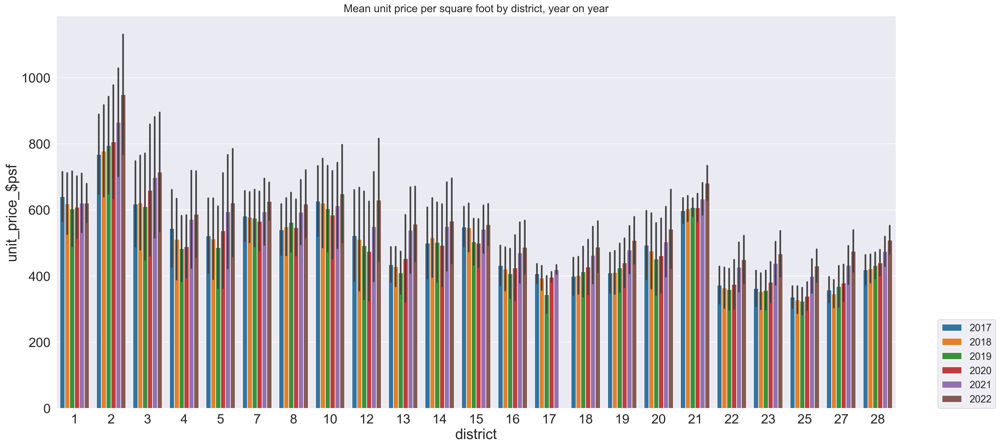

In [67]:
plt.figure(figsize=(25,12),dpi=200)
sns.barplot(
    data=df_hdb_cleaned,
    y='unit_price_$psf',
    x='district',
    hue=df_hdb_cleaned['year_sold'],
    ci='sd',
    estimator=np.mean,
    palette='tab10'
)
sns.set(font_scale = 1.5)
plt.legend(loc=(1.05,0))
plt.title('Mean unit price per square foot by district, year on year')
plt.show()

In [60]:
# export cleaned dataset
df_hdb_cleaned.to_csv('../data/df_hdb_cleaned.csv',index=False)